# Exploratory Data Analysis 

> This notebook presents an Exploratory Data Analysis (EDA) of the PMA machine used in the granulation process. 

<img src="Screenshot-2025-01-24-at-13.55.26.jpeg" width="50%" align="" />

Objectives

- Explore the raw data

- Identify patterns

- Detect anomalies 

- Understand key factors influencing machine performance  

By leveraging statistical summaries and visualizations, we aim to gain insights into process behavior, potential inefficiencies, and early indicators of maintenance needs. This EDA will serve as a foundation for further analysis, enabling data-driven decision-making for process optimization and predictive maintenance strategies.

> Questions

1. Is there any difference between sensor values before breakdown and after maintenance?
2. How to determine the optimal number of hours or days?

Assumption: Machine condition after maintenance represents a healthy machine condition

Theory: Difference in statistical values meant that we can capture the sensor pattern before breakdown is about to occur

What to Checks

- Statistical descriptive

- Time series visualization

- Occurence of outlier values

- Statistical test of time series

## Initial Setup & Data Pre-Processing

Import essentials library

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import datetime
import re

Load dataset

In [2]:
raw_data = pd.read_csv("/work/IoT DB/_cMT_FHDGEA1_EBR_PMA_data__202411251519.csv")
df_granulasi_dictionary = pd.read_excel("/work/IoT DB/metadata/SAKA IoT Data Dictionary.xlsx")

df_line_stop = pd.read_excel("/work/IoT DB/metadata/Data Line Stop Produksi sep 24.xlsx", skiprows=5, sheet_name="Line 1 2024")
df_line_stop_baru = pd.read_csv("/work/IoT DB/metadata/breakdown Granulasi Jan-Nov.csv", sep=";", header=None)
df_line_stop_combine = pd.read_excel("/work/IoT DB/metadata/breakdown_granulasi_baru.xlsx", sheet_name="Line 1 2024")

Rename column from data_format_x into each corresponding column name in dictionary

In [3]:
df_granulasi = raw_data.copy().drop(columns=["data_index"])
df_granulasi = df_granulasi.rename(columns={
    "data_format_0": "id_batch",
    "data_format_1": "id_process",
})
df_granulasi['time@timestamp'] = pd.to_datetime(df_granulasi['time@timestamp'], unit='s')

# rename columns
for col in raw_data.columns:
    if col in df_granulasi_dictionary["Column Name"].values:
        df_granulasi = df_granulasi.rename(columns={
            col: df_granulasi_dictionary[df_granulasi_dictionary["Column Name"] == col]["Parameter"].values[0]
        })

df_granulasi["id_batch"] = df_granulasi["id_batch"].apply(lambda x: x.split("\\u")[0])
df_granulasi["id_process"] = df_granulasi["id_process"].apply(lambda x: x.split("\\u")[0])

Display the PMA Dataset with the column name already renamed

In [4]:
with pd.option_context("display.max_columns", None):
    display(df_granulasi.head())

,time@timestamp,id_batch,id_process,Impeler loading speed (RPM),Filter clear interval time (sec),Waktu loading (menit),Chopper (RPM),% Pump speed,Ampere (A)
0,2024-08-24 13:29:28.416999936,STMXGF44310-1,VACUUM II,0.0,300,0,0.0,0.0,0.0
1,2024-08-24 13:30:29.780999936,STMXGF44310-1,VACUUM II,0.0,300,0,0.0,0.0,0.0
2,2024-08-24 13:31:29.228000000,STMXGF44310-1,VACUUM II,0.0,300,0,0.0,0.0,0.0
3,2024-08-24 13:32:29.125999872,STMXGF44310-1,VACUUM II,0.0,300,0,0.0,0.0,0.0
4,2024-08-24 13:33:28.609999872,STMXGF44310-1,VACUUM II,0.0,300,0,0.0,0.0,0.0


Visualize the Data with Time Series format

In [5]:
_dntk.DeepnoteChart(df_granulasi, """{"layer":[{"layer":[{"mark":{"clip":true,"type":"bar","color":"#2266D3","tooltip":true},"encoding":{"x":{"axis":{"grid":false},"sort":"ascending","type":"temporal","field":"time@timestamp","scale":{"type":"linear"}},"y":{"axis":{"grid":false},"sort":null,"type":"quantitative","field":"Impeler loading speed \\\\\\\\\\\\(RPM\\\\\\\\\\\\)","scale":{"type":"linear"},"format":{"type":"default","decimals":null},"formatType":"numberFormatFromNumberType"}}}]}],"title":"","config":{"legend":{}},"$schema":"https://vega.github.io/schema/vega-lite/v5.json","encoding":{},"usermeta":{"tooltipDefaultMode":true}}""")

## Data Summary and Statistics

### 1️⃣ Numerical Data Statistics

In [6]:
# Summary statistics for numerical columns
numerical_stats = df_granulasi.describe()

# Formatting for better readability
pd.set_option("display.float_format", "{:.2f}".format)  # Format numbers to 2 decimal places
pd.set_option("display.max_columns", None)  # Show all columns
pd.set_option("display.max_rows", None)  # Show all rows if needed

# Display results
print("📊 Numerical Statistics:")
display(numerical_stats)  # Clean table output

📊 Numerical Statistics:


,time@timestamp,Impeler loading speed (RPM),Filter clear interval time (sec),Waktu loading (menit),Chopper (RPM),% Pump speed,Ampere (A)
count,116174,116174.00,116174.00,116174.00,116174.00,116174.00,116174.00
mean,2024-10-14 15:41:07.277687552,5.91,177.73,7.57,153.92,0.14,3.65
min,2024-08-24 13:29:28.416999936,-6.09,1.00,0.00,0.00,0.00,0.00
25%,2024-09-25 00:31:27.796499968,0.00,10.00,1.00,0.00,0.00,0.00
50%,2024-10-16 04:52:26.225999872,0.00,200.00,10.00,0.00,0.00,0.00
75%,2024-11-05 10:54:27.455750144,0.00,300.00,10.00,0.00,0.00,0.00
max,2024-11-25 15:18:29.467000064,171.13,700.00,40.00,2500.00,75.00,53.91
std,NaN,25.40,182.90,6.61,551.77,2.89,8.92


### 2️⃣ Categorical Data Statistics

In [7]:
# Summary statistics for categorical columns
categorical_stats = df_granulasi.describe(include=["object"])

print("\n🔤 Categorical Statistics:")
display(categorical_stats)  # Clean table output


🔤 Categorical Statistics:


,id_batch,id_process
count,116174,116174
unique,225,32
top,STMXGE45439-2,discharge 9
freq,11290,31994


id_process value before cleaning

In [8]:
# Extract all values from the 'id_process' column
id_process_values = df_granulasi["id_process"]

unique_id_process = df_granulasi["id_process"].unique()
print(unique_id_process)


['VACUUM II' 'VACUUM I' 'MIXING I' 'Mixing II Dry Mixing II'
 'Mixing III add solution ' 'Mixing IV - Granulation' 'Discharge 4'
 'discharge 5' 'Discharge 1' 'Mixing I - Dry Mixing' 'discharge 9'
 'Discharge 12' 'Input Material' 'discharge 6' 'Mixing III Add Solution'
 'Discharge 2' 'Discharge 3' 'discharge 7' 'discharge 8' 'discharge 4'
 'input material' 'MIXING 1 dry mixing ' 'mixing 2 add solution'
 'mixing lll ' 'discharge 1' 'discharge 10' 'MIXING III' 'discharge 2'
 'discharge 3' 'MIXING II' 'MIXING IV' 'discharge 11']


### 3️⃣ Missing Values Summary

In [9]:
# Count of missing values in each column
missing_values = df_granulasi.isna().sum().reset_index()
missing_values.columns = ["Column Name", "Missing Values"]

print("\n❗ Missing Values in Each Column:")
display(missing_values)  # Clean table output


❗ Missing Values in Each Column:


,Column Name,Missing Values
0,time@timestamp,0
1,id_batch,0
2,id_process,0
3,Impeler loading speed (RPM),0
4,Filter clear interval time (sec),0
5,Waktu loading (menit),0
6,Chopper (RPM),0
7,% Pump speed,0
8,Ampere (A),0


### Mapping data on id_process

The `id_process` is manually entered by the operator, so we must ensure each process is mapped to the correct one

Create mapping function:

In [10]:
def get_id_process_type(x):
    """Classifies process type based on keywords in the string."""
    if pd.isna(x) or not isinstance(x, str):  # Handle NaN or non-string cases
        return None
    x = x.strip().lower()  # Normalize text: lowercase & strip spaces
    if "mixing" in x:
        return "Mixing"
    elif "discharge" in x:
        return "Discharge"
    elif "vacuum" in x:
        return "Vacuum"
    elif "input material" in x:  # Ensure consistent mapping
        return "Input Material"
    return None  # Return None for unmatched cases

def get_id_process_number(x):
    """Extracts and maps process numbers (I, II, 1, etc.) from the process name."""
    if pd.isna(x) or not isinstance(x, str):  # Handle NaN or non-string cases
        return None
    x_split = x.lower().split()  # Ensure string and split words
    mapping = {
        "1": "1", "i": "1", "one": "1",
        "2": "2", "ii": "2", "two": "2",
        "3": "3", "iii": "3", "three": "3", "lll": "3",
        "4": "4", "iv": "4", "four": "4",
        "5": "5", "v": "5", "five": "5",
        "6": "6", "vi": "6", "six": "6",
        "7": "7", "vii": "7", "seven": "7",
        "8": "8", "viii": "8", "eight": "8",
        "9": "9", "ix": "9", "nine": "9",
        "10": "10", "x": "10", "ten": "10",
        "11": "11", "xi": "11", "eleven": "11",
        "12": "12", "xii": "12", "twelve": "12",
        "13": "13", "xiii": "13", "thirteen": "13"
    }

    for word in x_split:
        if word in mapping:
            return mapping[word]  # Ensure it returns a string
    
    return None  # Return None if no number is found

def extract_clean_id_process(df):
    """Cleans and categorizes the id_process column."""
    df = df.copy()
    
    # Standardize id_process: convert to lowercase and strip spaces
    df["id_process"] = df["id_process"].astype(str).str.strip().str.lower()
    
    # Apply the mapping functions
    df["id_process_type"] = df["id_process"].map(get_id_process_type)
    df["id_process_number"] = df["id_process"].map(get_id_process_number)
    
    # Construct id_process_new only when type or number is found (no underscores)
    df["id_process_new"] = df.apply(
        lambda row: f"{row['id_process_type']} {row['id_process_number']}".strip()
        if pd.notna(row["id_process_type"]) and pd.notna(row["id_process_number"])
        else row["id_process_type"] if pd.notna(row["id_process_type"])
        else row["id_process_number"] if pd.notna(row["id_process_number"])
        else None,
        axis=1
    )

    # Select required columns
    df = df[['time@timestamp', 'id_batch', 'id_process', 'id_process_type', 
             'id_process_number', 'id_process_new', 'Impeler loading speed (RPM)', 
             'Filter clear interval time (sec)', 'Waktu loading (menit)', 
             'Chopper (RPM)', '% Pump speed', 'Ampere (A)']]

    return df

Apply and check the mapping result

In [11]:
# Apply the function
df_granulasi_cleaned = extract_clean_id_process(df_granulasi)

# Check unique values in id_process_new after cleaning
unique_values = df_granulasi_cleaned["id_process_new"].unique()
print("Unique values after normalization:", unique_values)

# Verify all "Input Material" variations are mapped correctly
input_material_check = df_granulasi_cleaned[df_granulasi_cleaned["id_process_new"] == "Input Material"]
display(input_material_check)

Unique values after normalization: ['Vacuum 2' 'Vacuum 1' 'Mixing 1' 'Mixing 2' 'Mixing 3' 'Mixing 4'
 'Discharge 4' 'Discharge 5' 'Discharge 1' 'Discharge 9' 'Discharge 12'
 'Input Material' 'Discharge 6' 'Discharge 2' 'Discharge 3' 'Discharge 7'
 'Discharge 8' 'Discharge 10' 'Discharge 11']


,time@timestamp,id_batch,id_process,id_process_type,id_process_number,id_process_new,Impeler loading speed (RPM),Filter clear interval time (sec),Waktu loading (menit),Chopper (RPM),% Pump speed,Ampere (A)
7138,2024-08-29 12:50:12.526000128,STMXGE44417-1,input material,Input Material,None,Input Material,0.00,10,0,0.00,0.00,0.00
7139,2024-08-29 12:51:15.968000000,STMXGE44417-1,input material,Input Material,None,Input Material,4.60,1,8,0.00,0.00,24.08
7140,2024-08-29 12:52:14.119000064,STMXGE44417-1,input material,Input Material,None,Input Material,5.17,1,8,0.00,0.00,23.67
7141,2024-08-29 12:53:14.016999936,STMXGE44417-1,input material,Input Material,None,Input Material,4.89,1,8,0.00,0.00,24.12
7142,2024-08-29 12:54:12.813999872,STMXGE44417-1,input material,Input Material,None,Input Material,5.10,1,8,0.00,0.00,23.38
7143,2024-08-29 12:55:13.145999872,STMXGE44417-1,input material,Input Material,None,Input Material,5.17,1,8,0.00,0.00,23.64
7144,2024-08-29 12:56:12.025000192,STMXGE44417-1,input material,Input Material,None,Input Material,4.46,1,8,0.00,0.00,22.97
7145,2024-08-29 12:57:15.024000000,STMXGE44417-1,input material,Input Material,None,Input Material,5.74,1,8,0.00,0.00,24.05
7146,2024-08-29 12:58:14.210000128,STMXGE44417-1,input material,Input Material,None,Input Material,0.00,1,8,0.00,0.00,0.00
7147,2024-08-29 12:59:13.601999872,STMXGE44417-1,input material,Input Material,None,Input Material,5.17,1,8,0.00,0.00,23.10


Check NaN values

In [12]:
nan_count = df_granulasi_cleaned["id_process_new"].isna().sum()
print(f"Total NaN values in 'id_process_new': {nan_count}")


Total NaN values in 'id_process_new': 0


Check count of id_process_new

In [13]:
# Display the full count of unique 'id_process_new' values, including NaN
df_counts = df_granulasi_cleaned["id_process_new"].value_counts(dropna=False).reset_index()

# Rename columns for clarity
df_counts.columns = ["id_process_new", "count"]

# Sort the DataFrame in ascending order by the 'id_process_new' column
df_counts = df_counts.sort_values(by="id_process_new", ascending=True)

# Display all rows
pd.set_option("display.max_rows", None)

# Show the table
display(df_counts)  # Works in Jupyter Notebook

,id_process_new,count
7,Discharge 1,5634
8,Discharge 10,3007
16,Discharge 11,76
2,Discharge 12,9219
14,Discharge 2,272
9,Discharge 3,2759
4,Discharge 4,7762
12,Discharge 5,443
17,Discharge 6,68
15,Discharge 7,156


Visualize the count of id_process_new

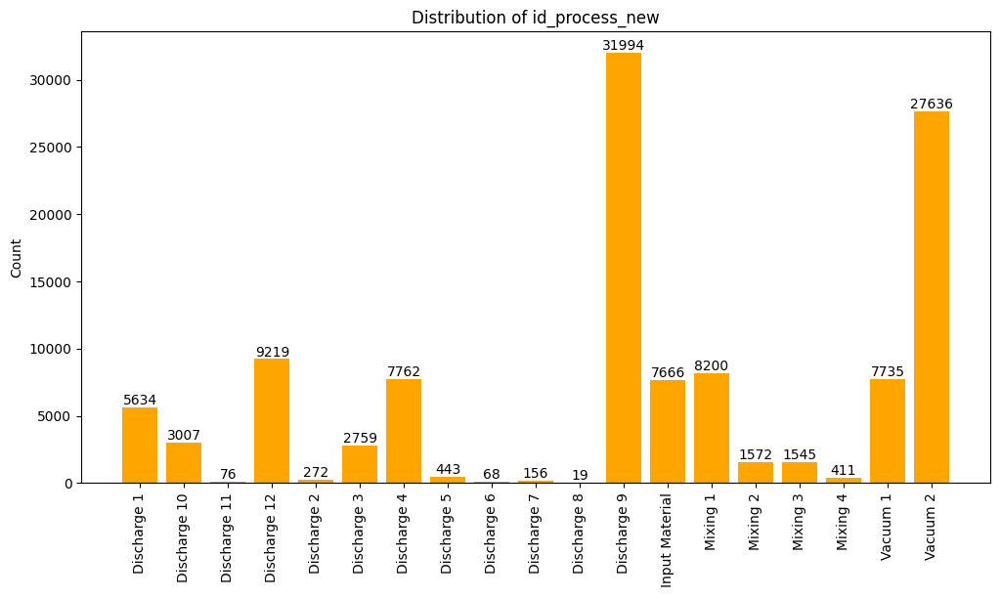

In [14]:
# Create a bar chart with exact count labels on each bar
plt.figure(figsize=(12, 6))
bars = plt.bar(df_counts["id_process_new"], df_counts["count"], color="orange")

# Add value labels on top of each bar
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, str(yval), ha='center', va='bottom', fontsize=10)

# Formatting
plt.xticks(rotation=90)  # Rotate labels for readability
plt.ylabel("Count")
plt.title("Distribution of id_process_new")

# Show plot
plt.show()

In [15]:
_dntk.DeepnoteChart(df_granulasi_cleaned, """{"layer":[{"layer":[{"mark":{"clip":true,"type":"bar","color":"#2266D3","tooltip":true},"encoding":{"x":{"axis":{"grid":false},"sort":"ascending","type":"nominal","field":"id_process_new","scale":{"type":"linear"}},"y":{"axis":{"grid":false},"sort":null,"type":"quantitative","scale":{"type":"linear"},"format":{"type":"default","decimals":null},"aggregate":"count","formatType":"numberFormatFromNumberType"}}}]}],"title":"","config":{"legend":{}},"$schema":"https://vega.github.io/schema/vega-lite/v5.json","encoding":{},"usermeta":{"tooltipDefaultMode":true}}""")

## Remove Data When the Machine is not Running

Preprocessing Steps: Drop all signal data whose Impeller Loading Speed (RPM) is less than or equal to 0

In [16]:
df_granulasi_cleaned = df_granulasi_cleaned[df_granulasi_cleaned["Impeler loading speed (RPM)"] > 0]
df_granulasi_cleaned

,time@timestamp,id_batch,id_process,id_process_type,id_process_number,id_process_new,Impeler loading speed (RPM),Filter clear interval time (sec),Waktu loading (menit),Chopper (RPM),% Pump speed,Ampere (A)
2494,2024-08-26 07:10:50.118000128,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,5.10,15,10,0.00,0.00,22.61
2495,2024-08-26 07:11:49.980000000,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,5.03,15,10,0.00,0.00,23.21
2496,2024-08-26 07:12:50.378000128,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,4.89,15,10,0.00,0.00,24.38
2497,2024-08-26 07:13:49.060000000,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,5.17,15,10,0.00,0.00,25.14
2498,2024-08-26 07:14:49.823000064,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,4.82,15,10,0.00,0.00,23.90
2499,2024-08-26 07:15:48.936999936,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,4.60,15,10,0.00,0.00,23.47
2500,2024-08-26 07:16:49.517999872,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,4.46,15,10,0.00,0.00,24.05
2501,2024-08-26 07:17:51.016000000,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,5.10,15,10,0.00,0.00,23.19
2502,2024-08-26 07:18:47.946000128,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,5.17,15,10,0.00,0.00,23.02
2503,2024-08-26 07:19:50.826999808,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,52.28,15,10,0.00,0.00,26.00


Check value after cleaning data

In [17]:
len(df_granulasi_cleaned["id_process"].unique())

26

In [18]:
# Replace these values with your actual counts
before_cleaning_count = df_granulasi.shape[0]
after_cleaning_count = df_granulasi_cleaned.shape[0]
removed_count = before_cleaning_count - after_cleaning_count
retained_percentage = (after_cleaning_count / before_cleaning_count) * 100
removed_percentage = 100 - retained_percentage

# Create a comparison table
comparison_table = pd.DataFrame({
    "Metric": ["Total Rows Before Cleaning", "Total Rows After Cleaning", "Rows Removed", "Retained Data (%)", "Removed Data (%)"],
    "Value": [before_cleaning_count, after_cleaning_count, removed_count, round(retained_percentage, 2), round(removed_percentage, 2)]
})

comparison_table

,Metric,Value
0,Total Rows Before Cleaning,116174.00
1,Total Rows After Cleaning,17427.00
2,Rows Removed,98747.00
3,Retained Data (%),15.00
4,Removed Data (%),85.00


In [19]:
# Create separate DataFrames for Bar Chart and Pie Chart
df_bar = pd.DataFrame({
    "Stage": ["Before Cleaning", "After Cleaning"],
    "Count": [before_cleaning_count, after_cleaning_count]
})

df_pie = pd.DataFrame({
    "Category": ["Retained Data", "Removed Data"],
    "Percentage": [retained_percentage, removed_percentage]
})



In [20]:
_dntk.DeepnoteChart(df_bar, """{"layer":[{"layer":[{"mark":{"clip":true,"type":"bar","color":"#2266D3","tooltip":true},"encoding":{"x":{"axis":{"grid":false},"sort":null,"type":"nominal","field":"Stage","scale":{"type":"linear"}},"y":{"axis":{"grid":false},"sort":null,"type":"quantitative","field":"Count","scale":{"type":"linear"},"format":{"type":"default","decimals":null},"aggregate":"sum","formatType":"numberFormatFromNumberType"}}}]}],"title":"","config":{"legend":{}},"$schema":"https://vega.github.io/schema/vega-lite/v5.json","encoding":{},"usermeta":{"tooltipDefaultMode":true}}""")

In [21]:
_dntk.DeepnoteChart(df_pie, """{"layer":[{"layer":[{"mark":{"clip":true,"type":"arc","tooltip":true,"innerRadius":{"expr":"min(width, height) / 5"},"outerRadius":{"expr":"min(width, height) / 2"}},"encoding":{"color":{"axis":{"grid":false},"sort":null,"type":"nominal","field":"Category","scale":{"scheme":"deepnote10"}},"order":{"axis":{"grid":false},"sort":"descending","type":"quantitative","field":"Percentage","scale":{"type":"linear"},"aggregate":"sum"},"theta":{"axis":{"grid":false},"sort":null,"type":"quantitative","field":"Percentage","scale":{"type":"linear"},"stack":true,"aggregate":"sum"},"tooltip":[{"axis":{"grid":false},"sort":null,"type":"nominal","field":"Category","scale":{"scheme":"deepnote10"}},{"sort":null,"type":"quantitative","field":"Percentage","aggregate":"sum"}]}},{"mark":{"dx":0,"dy":-1,"fill":"black","type":"text","align":"center","radius":{"expr":"min(width, height) / 2 + 30"},"baseline":"bottom"},"encoding":{"text":{"sort":null,"type":"quantitative","field":"Percentage","aggregate":"sum"},"color":{"axis":{"grid":false},"sort":null,"type":"nominal","field":"Category","scale":{"scheme":"deepnote10"}},"order":{"axis":{"grid":false},"sort":"descending","type":"quantitative","field":"Percentage","scale":{"type":"linear"},"aggregate":"sum"},"theta":{"axis":{"grid":false},"sort":null,"type":"quantitative","field":"Percentage","scale":{"type":"linear"},"stack":true,"aggregate":"sum"},"tooltip":[{"axis":{"grid":false},"sort":null,"type":"nominal","field":"Category","scale":{"scheme":"deepnote10"}},{"sort":null,"type":"quantitative","field":"Percentage","aggregate":"sum"}]}}]}],"title":"","config":{"legend":{}},"$schema":"https://vega.github.io/schema/vega-lite/v5.json","encoding":{},"usermeta":{"tooltipDefaultMode":true}}""")

Check sensor and correlations

Sensor Columns

- Impeler loading speed (RPM) 

- Filter clear interval time (sec)

- Waktu loading (menit)

- Chopper (RPM)

- % Pump speed

- Ampere (A)

In [22]:
# List of columns to analyze
sensor_columns = [
    'Impeler loading speed (RPM)', 
    'Filter clear interval time (sec)', 
    'Waktu loading (menit)', 
    'Chopper (RPM)', 
    '% Pump speed',
    'Ampere (A)'
]

In [23]:
df_granulasi_cleaned[sensor_columns].corr()

,Impeler loading speed (RPM),Filter clear interval time (sec),Waktu loading (menit),Chopper (RPM),% Pump speed,Ampere (A)
Impeler loading speed (RPM),1.00,-0.03,0.02,0.36,NaN,-0.21
Filter clear interval time (sec),-0.03,1.00,-0.51,0.00,NaN,-0.00
Waktu loading (menit),0.02,-0.51,1.00,-0.06,NaN,-0.05
Chopper (RPM),0.36,0.00,-0.06,1.00,NaN,0.01
% Pump speed,NaN,NaN,NaN,NaN,NaN,NaN
Ampere (A),-0.21,-0.00,-0.05,0.01,NaN,1.00


### Separate Between Dates

In [24]:
def get_values_between_dates(df, year, month, day, day_time_window):
    """
        Logicnya ambil tanggal akhir terus dikurang beberapa hari day_time_window
        Misal Tgl: 8 Agustus 2024, day_time_window = 10
        Berarti rentang waktu yang diambil:
        - Awal  : 29 Juli 2024
        - Akhir : 08 Agustus 2024 
    """
    df = df.copy()
    
    # Define the start and end times
    start_time = datetime.datetime(year, month, day) - datetime.timedelta(days=day_time_window)
    end_time = datetime.datetime(year, month, day)
    
    print("Start Time:\n", start_time.date())
    print("End Time:\n", end_time.date())
    
    # Ensure the timestamp column is in datetime format
    df["time@timestamp"] = pd.to_datetime(df["time@timestamp"])
    
    # Apply filters
    start_filter = df["time@timestamp"] > start_time
    end_filter = df["time@timestamp"] <= end_time
    df = df[start_filter & end_filter]
    df = df.set_index("time@timestamp")
    # return df.iloc[:, 2:]
    return df

In [25]:
def get_values_between_dates_v2(df, year, month, day, day_time_window):
    """
    Logic:
    - Takes an end date (year, month, day) and subtracts 'day_time_window' days to get the start date.
    - If the day is out of range (e.g., 40th day of September), it automatically corrects to the next month.
    - Ensures timestamp filtering is applied correctly.

    Example:
    - Given: 8 August 2024, day_time_window = 10
    - Start Date: 29 July 2024
    - End Date: 8 August 2024 
    """

    df = df.copy()

    # Fix: Adjust invalid 'day' values using timedelta
    base_date = datetime.datetime(year, month, 1) + datetime.timedelta(days=day - 1)

    # Define start and end times
    start_time = base_date - datetime.timedelta(days=day_time_window)
    end_time = base_date

    print("Start Time:\n", start_time.date())
    print("End Time:\n", end_time.date())

    # Ensure the timestamp column is in datetime format
    df["time@timestamp"] = pd.to_datetime(df["time@timestamp"])

    # Apply filters
    df_filtered = df[(df["time@timestamp"] > start_time) & (df["time@timestamp"] <= end_time)]
    df_filtered = df_filtered.set_index("time@timestamp")

    print("Num rows:", df_filtered.shape[0])

    return df_filtered

> User can adjust the value on the `time_window` box to check prior breakdown and after maintenance

In [26]:
time_window = '90'

In [27]:
# Ensure time_window is an integer
time_window = int(time_window)

df_sebelum_9_2 = get_values_between_dates_v2(
    df_granulasi_cleaned,
    year=2024,
    month=9,
    day=2,
    day_time_window=time_window  # Ensure this is an integer
)

print()

df_setelah_9_12 = get_values_between_dates_v2(
    df_granulasi_cleaned,
    year=2024,
    month=9,
    day=12 + time_window,  # Ensure numeric operation is valid
    day_time_window=time_window  # Ensure this is an integer
)

Start Time:
 2024-06-04
End Time:
 2024-09-02
Num rows: 1207

Start Time:
 2024-09-12
End Time:
 2024-12-11
Num rows: 16015


Now we have obtained the two dfs based on the number of time_window prior breakdown and after maintenance, we can do further analysis

Prior Breakdown

In [28]:
df_sebelum_9_2.head()

,id_batch,id_process,id_process_type,id_process_number,id_process_new,Impeler loading speed (RPM),Filter clear interval time (sec),Waktu loading (menit),Chopper (RPM),% Pump speed,Ampere (A)
time@timestamp,,,,,,,,,,,
2024-08-26 07:10:50.118000128,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,5.10,15,10,0.00,0.00,22.61
2024-08-26 07:11:49.980000000,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,5.03,15,10,0.00,0.00,23.21
2024-08-26 07:12:50.378000128,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,4.89,15,10,0.00,0.00,24.38
2024-08-26 07:13:49.060000000,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,5.17,15,10,0.00,0.00,25.14
2024-08-26 07:14:49.823000064,STMXGF44310-2,vacuum ii,Vacuum,2,Vacuum 2,4.82,15,10,0.00,0.00,23.90


After Maintenance

In [29]:
df_setelah_9_12.head()

,id_batch,id_process,id_process_type,id_process_number,id_process_new,Impeler loading speed (RPM),Filter clear interval time (sec),Waktu loading (menit),Chopper (RPM),% Pump speed,Ampere (A)
time@timestamp,,,,,,,,,,,
2024-09-12 01:03:15.165999872,TRIAL PLACEBO,discharge 12,Discharge,12,Discharge 12,19.76,200,1,0.00,0.00,25.24
2024-09-12 01:04:13.302000128,TRIAL PLACEBO,discharge 12,Discharge,12,Discharge 12,19.98,200,1,0.00,0.00,24.94
2024-09-12 01:05:12.546000128,TRIAL PLACEBO,discharge 12,Discharge,12,Discharge 12,20.33,200,1,0.00,0.00,25.11
2024-09-12 01:06:16.027000064,TRIAL PLACEBO,discharge 12,Discharge,12,Discharge 12,19.76,200,1,0.00,0.00,24.29
2024-09-12 01:07:14.073999872,TRIAL PLACEBO,discharge 12,Discharge,12,Discharge 12,19.98,200,1,0.00,0.00,24.57


Filter the two set of processes. Later on we will only focus on signal values of these processes.

In [30]:
valid_process_values = set(
    df_sebelum_9_2["id_process_new"].value_counts().index
).intersection(
    set(df_setelah_9_12["id_process_new"].value_counts().index)
)
valid_process_values = sorted(list(valid_process_values))

valid_process_values

['Discharge 1',
 'Discharge 12',
 'Discharge 4',
 'Discharge 5',
 'Discharge 6',
 'Discharge 9',
 'Input Material',
 'Mixing 1',
 'Mixing 2',
 'Mixing 3',
 'Mixing 4',
 'Vacuum 1',
 'Vacuum 2']

Check Rolling Corellation

In [31]:
def check_rolling_correlation(df_before, df_after, valid_process_values):
    for col in valid_process_values:
        print("Checking col:", col)
        dfb = df_before[df_before["id_process_new"] == col].copy()
        dfa = df_after[df_after["id_process_new"] == col].copy()

        dfb_roll = dfb[sensor_columns]\
            .rolling(60)\
            .corr(dfb["Impeler loading speed (RPM)"])[["Chopper (RPM)", "Ampere (A)"]]\
            .dropna(axis=0)
        
        dfa_roll = dfa[sensor_columns]\
            .rolling(60)\
            .corr(dfa["Impeler loading speed (RPM)"])[["Chopper (RPM)", "Ampere (A)"]]\
            .dropna(axis=0)

        if len(dfb_roll) == 0 or len(dfa_roll) == 0:
            print("     Skipped.\n")
            continue

        print("Dataframe Before")
        display(dfb_roll.describe())
        
        print("Dataframe After")
        display(dfa_roll.describe())

In [32]:
import warnings

# Suppress RuntimeWarnings related to NaN issues
warnings.filterwarnings("ignore", category=RuntimeWarning)

def check_rolling_correlation_v2(df_before, df_after, valid_process_values):
    for col in valid_process_values:
        dfb = df_before[df_before["id_process_new"] == col].copy()
        dfa = df_after[df_after["id_process_new"] == col].copy()

        # Ensure NaN values are handled properly before calculations
        dfb[sensor_columns] = dfb[sensor_columns].fillna(0)
        dfa[sensor_columns] = dfa[sensor_columns].fillna(0)

        dfb_roll = dfb[sensor_columns]\
            .rolling(60)\
            .corr(dfb["Impeler loading speed (RPM)"].fillna(0))[["Chopper (RPM)", "Ampere (A)"]]\
            .dropna(axis=0)
        
        dfa_roll = dfa[sensor_columns]\
            .rolling(60)\
            .corr(dfa["Impeler loading speed (RPM)"].fillna(0))[["Chopper (RPM)", "Ampere (A)"]]\
            .dropna(axis=0)

        # Only print if there is valid data
        if len(dfb_roll) > 0 and len(dfa_roll) > 0:
            print(f"Checking col: {col}")

            # Compute summary statistics
            dfb_desc = dfb_roll.describe()
            dfa_desc = dfa_roll.describe()

            # Combine into a single DataFrame for side-by-side display
            combined_desc = pd.concat([dfb_desc, dfa_desc], axis=1, keys=["Before", "After"])
            
            print("Combined Summary Statistics (Before vs After):")
            display(combined_desc)


In [33]:
# Run the function
check_rolling_correlation_v2(
    df_before=df_sebelum_9_2,
    df_after=df_setelah_9_12,
    valid_process_values=valid_process_values
)

Checking col: Discharge 1
Combined Summary Statistics (Before vs After):


Before                    After           
      Chopper (RPM) Ampere (A) Chopper (RPM) Ampere (A)
count        114.00     114.00        324.00     324.00
mean           0.20      -0.47         -0.27      -0.57
std            0.26       0.31          0.46       0.30
min           -0.18      -0.80         -0.93      -0.88
25%           -0.02      -0.73         -0.64      -0.80
50%            0.13      -0.59         -0.42      -0.71
75%            0.42      -0.15          0.19      -0.25
max            0.69       0.15          0.63       0.32

Checking col: Discharge 12
Combined Summary Statistics (Before vs After):


Before                    After           
      Chopper (RPM) Ampere (A) Chopper (RPM) Ampere (A)
count         14.00      14.00        184.00     184.00
mean           0.75      -0.03          0.53      -0.53
std            0.13       0.02          0.32       0.31
min            0.55      -0.06         -0.08      -0.85
25%            0.64      -0.04          0.44      -0.77
50%            0.74      -0.03          0.66      -0.64
75%            0.85      -0.03          0.73      -0.39
max            0.94       0.02          0.92       0.63

Checking col: Discharge 9
Combined Summary Statistics (Before vs After):


Before                    After           
      Chopper (RPM) Ampere (A) Chopper (RPM) Ampere (A)
count         64.00      64.00       1180.00    1180.00
mean           0.06      -0.80          0.22      -0.64
std            0.10       0.05          0.28       0.16
min           -0.05      -0.89         -0.37      -0.91
25%           -0.02      -0.85          0.04      -0.75
50%            0.01      -0.79          0.18      -0.69
75%            0.13      -0.77          0.42      -0.57
max            0.33      -0.59          0.79      -0.02

Checking col: Mixing 2
Combined Summary Statistics (Before vs After):


Before                    After           
      Chopper (RPM) Ampere (A) Chopper (RPM) Ampere (A)
count          3.00       3.00        575.00     575.00
mean          -0.19      -0.34           NaN      -0.23
std            0.03       0.01           NaN       0.31
min           -0.21      -0.35          -inf      -0.72
25%           -0.21      -0.34         -0.13      -0.56
50%           -0.20      -0.34         -0.06      -0.11
75%           -0.18      -0.34          0.01       0.03
max           -0.15      -0.33           inf       0.33

Checking col: Vacuum 2
Combined Summary Statistics (Before vs After):


Before                    After           
      Chopper (RPM) Ampere (A) Chopper (RPM) Ampere (A)
count        495.00     495.00       2871.00    2871.00
mean           0.44      -0.25          0.33       0.09
std            0.22       0.34          0.18       0.24
min            0.09      -0.82         -0.21      -0.89
25%            0.29      -0.63          0.22       0.02
50%            0.34      -0.14          0.32       0.14
75%            0.56       0.01          0.38       0.23
max            0.95       0.38          0.99       0.78

### Entire Correlation

Prior Breakdown

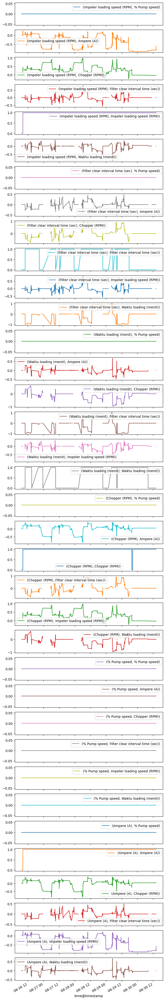

In [34]:
df_sebelum_9_2[sensor_columns].rolling(60).corr().unstack().iloc[:, :].fillna(0).plot(subplots=True, figsize=(8, 60));

After Maintenance

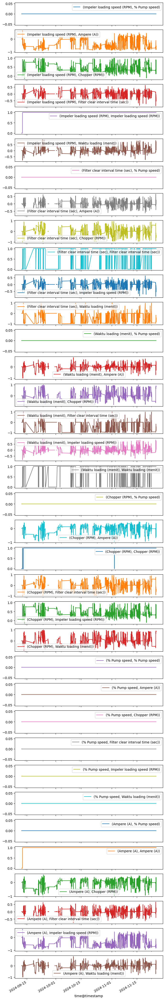

In [35]:
df_setelah_9_12[sensor_columns].rolling(60).corr().unstack().iloc[:, :].fillna(0).plot(subplots=True, figsize=(8, 60));

In [36]:
from datetime import datetime

def plot_with_breakdown_intervals(
    df, breakdown_df, 
    x_start_time_window = None,
    x_end_time_window = None
):
    """
    Plots the data with vertical lines indicating breakdown intervals.

    Parameters:
    - df: The input DataFrame to plot.
    - breakdown_df: DataFrame containing 'TANGGAL', 'MULAI', 'SELESAI' columns.
    """
    df = df.copy()
    breakdown_df = breakdown_df.copy()

    # Helper function to clean and validate time columns
    def clean_time_column(time_col):
        """
        Ensures time_col has valid time strings.
        """
        cleaned = []
        for time_value in time_col:
            try:
                # Attempt to parse as time only
                parsed_time = datetime.strptime(str(time_value), "%H:%M:%S")
                if 0 <= parsed_time.hour <= 23:  # Ensure hours are within valid range
                    cleaned.append(str(time_value))
                else:
                    cleaned.append("00:00:00")  # Default invalid hours to 00:00:00
            except ValueError:
                # If invalid, replace with a default valid time
                cleaned.append("00:00:00")
        return cleaned

    # Clean and validate time columns
    breakdown_df["MULAI"] = clean_time_column(breakdown_df["MULAI"])
    breakdown_df["SELESAI"] = clean_time_column(breakdown_df["SELESAI"])

    # Combine TANGGAL with MULAI and SELESAI to create full datetime
    def combine_date_time(row):
        try:
            combined_datetime = pd.to_datetime(f"{row['TANGGAL']} {row['MULAI']}")
            if combined_datetime.year == 2024 and combined_datetime.month >= 8:  # Filter year and month
                return combined_datetime
            else:
                return None
        except Exception:
            return None

    def combine_date_time_end(row):
        try:
            combined_datetime = pd.to_datetime(f"{row['TANGGAL']} {row['SELESAI']}")
            if combined_datetime.year == 2024 and combined_datetime.month >= 8:  # Filter year and month
                return combined_datetime
            else:
                return None
        except Exception:
            return None

    # Apply the combination logic
    breakdown_df["MULAI"] = breakdown_df.apply(combine_date_time, axis=1)
    breakdown_df["SELESAI"] = breakdown_df.apply(combine_date_time_end, axis=1)

    # Drop rows with invalid dates
    breakdown_df = breakdown_df.dropna(subset=["MULAI", "SELESAI"])

    # display(breakdown_df[["MULAI", "SELESAI"]].head())

    # Filter the main df for year, month, and valid timestamp
    df = df[df["time@timestamp"].dt.year == 2024]
    df = df[df["time@timestamp"].dt.month >= 8]
    df = df[(df["time@timestamp"].dt.hour >= 0) & (df["time@timestamp"].dt.hour <= 23)]

    # Get minimum month and day from df["time@timestamp"]
    df_min_month = df["time@timestamp"].dt.month.min()
    df_min_day = df["time@timestamp"].dt.day.min()

    # Filter breakdown_df based on the minimum month and day from df
    breakdown_df = breakdown_df[
        (breakdown_df["MULAI"].dt.month > df_min_month) |
        ((breakdown_df["MULAI"].dt.month == df_min_month) & (breakdown_df["MULAI"].dt.day >= df_min_day))
    ]

    breakdown_df = breakdown_df[
        (breakdown_df["SELESAI"].dt.month > df_min_month) |
        ((breakdown_df["SELESAI"].dt.month == df_min_month) & (breakdown_df["SELESAI"].dt.day >= df_min_day))
    ]

    # Extract starts and ends
    starts = breakdown_df["MULAI"]
    ends = breakdown_df["SELESAI"]

    # Ensure starts and ends are pandas datetime for compatibility
    starts = pd.to_datetime(starts)
    ends = pd.to_datetime(ends)

    # Ensure lengths of starts and ends are equal
    assert len(starts) == len(ends), "The lengths of starts and ends must be equal."

    # Drop unnecessary columns and set index
    for col in ["id_batch", "id_process", "id_process_type", "id_process_number", "id_process_new"]:
        if col in df.columns:
            df = df.drop(columns=col)
    df = df.set_index("time@timestamp")       

    # Plot the data
    ax = df.plot(subplots=True, figsize=(8, 60), title="Data Visualization")

    # Specify the starting datetime for the x-axis
    if x_start_time_window is None:
        x_start_time_window = datetime(2024, 8, 24, 0, 0, 0)  # Example: August 1, 2024, 12:00 PM
    if x_end_time_window is None:
        x_end_time_window = datetime(2024, 10, 1, 0, 0, 0)

    # # Add vertical lines for each breakdown interval
    # for start, end in zip(starts, ends):
    #     # print((start, "-", end))
    #     for a in ax:
    #         a.axvline(x=start, color="red", linestyle="--", label="Breakdown Start")
    #         a.axvline(x=end, color="green", linestyle="--", label="Breakdown End")
    #         a.set_xlim(left=x_start, right=x_end)
    
    # Add shaded boxes for each breakdown interval
    for start, end in zip(starts, ends):
        for a in ax:
            a.axvspan(start, end, color="red", alpha=0.3, label="Breakdown Interval")
            a.set_xlim(left=x_start_time_window, right=x_end_time_window)

    # Add shaded boxes for weekends
    current_date = x_start_time_window
    while current_date < x_end_time_window:
        if current_date.weekday() >= 5:  # Saturday (5) or Sunday (6)
            weekend_start = pd.to_datetime(current_date)
            weekend_end = pd.to_datetime(current_date + pd.Timedelta(days=1))
            for a in ax:
                a.axvspan(weekend_start, weekend_end, color="blue", alpha=0.1, label="Weekend")
        current_date += pd.Timedelta(days=1)

    # Add legend to each subplot and deduplicate labels
    for a in ax:
        handles, labels = a.get_legend_handles_labels()
        unique = dict(zip(labels, handles))  # Remove duplicate labels
        a.legend(unique.values(), unique.keys(), loc="upper right")  # Add legend to upper right

    plt.tight_layout()
    plt.show()

In [37]:
df_filter = df_line_stop_combine.drop(columns=["NO", "PIC ", "Unnamed: 13", "Unnamed: 14", "NO WR"])
df_bd_granulasi = df_filter[df_filter["MESIN"] == "GRANULASI"].copy()
df_bd_granulasi.loc[:, "HARI"] = df_bd_granulasi["TANGGAL"].dt.day
df_bd_granulasi = df_bd_granulasi[df_bd_granulasi["BREAKDOWN / NO BREAKDOWN"] == "BD"]


### Rolling Correlation 

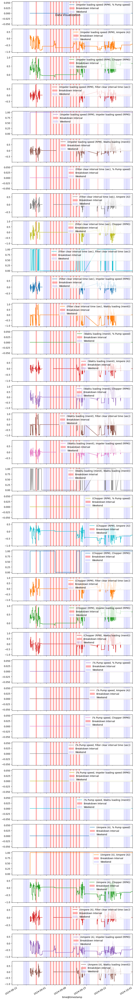

In [38]:
_df_granulasi_sensor = df_granulasi_cleaned.set_index("time@timestamp")[sensor_columns].rolling(60).corr().unstack().reset_index(drop=False).iloc[:, :].fillna(0)

plot_with_breakdown_intervals(
    _df_granulasi_sensor, df_bd_granulasi,
    x_start_time_window = datetime(2024, 8, 20, 0, 0, 0),  # Example: August 1, 2024, 12:00 PM <-> datetime(2024, 8, 24, 0, 0, 0)
    x_end_time_window = datetime(2024, 10, 1, 0, 0, 0)
)

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=079803a5-3867-4dca-9f09-ee071581eff9' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>